<a href="https://colab.research.google.com/github/markyao6275/DefinitelyTyped/blob/master/fluency_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Github Setup

Follow the instructions to set up Github in https://bebi103a.github.io/lessons/02/git_with_colab.html.

To commit changes to Github, click the Keyboard on the bottom left, search for "Save a copy in Github", choose the `fluency-nb` repository and push to `main`.

Please make sure to put sensitive variables in `drive/MyDrive/fluency/fluency_nb_env`. This notebook is checked into [Github](https://github.com/markyao6275/fluency-nb) and sentitive credentials should not be checked in.

# Imports & Initialization

In [8]:
import os
import json

TEACHER_NAME = 'Teacher'
ROOT_DIR = os.path.join('drive', 'MyDrive', 'fluency')
WORKING_SUB_DIR = os.path.join('orgs', 'demo', 'kenza')
WORKING_DIR = os.path.join(ROOT_DIR, WORKING_SUB_DIR)
ORIGINAL_FILE_NAME = 'kenza.m4a'
ORIGINAL_FILE_EXTENSION = ORIGINAL_FILE_NAME.split('.')[-1]
OUTPUT_JSON_FILE_NAME = 'test.json'
NUM_GRAMMAR_FEEDBACK = 7
CONFIDENCE_THRESHOLD = 0.5
AUDIO_FILE = os.path.join(WORKING_DIR, 'audio.wav')

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
!pip install imageio==2.4.1 --quiet
!pip install azure-storage-blob --quiet
!pip install pydub --quiet
!pip install revChatGPT --quiet
!pip install azure-cognitiveservices-speech
!pip install python-dotenv

# following instructions in https://github.com/Azure-Samples/cognitive-services-speech-sdk/tree/master/samples/batch/python
!pip install drive/MyDrive/fluency/python-client --quiet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done


In [13]:
import requests
import json
import math
import csv
import nltk
from nltk.stem import WordNetLemmatizer

from nltk.corpus import wordnet 
from IPython.core.display import HTML
import IPython.display as ipd
from revChatGPT.V1 import Chatbot
from pydub import AudioSegment
import random
import uuid
from azure.storage.blob import BlobServiceClient
import logging
import platform
import pickle
from datetime import datetime
import dotenv


nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
nltk.download('omw-1.4')

# load env variables
dotenv.load_dotenv(os.path.join(ROOT_DIR, 'fluency_nb_env'))
AZURE_SUBSCRIPTION_KEY = os.environ['AZURE_SUBSCRIPTION_KEY']
AZURE_SERVICE_REGION = os.environ['AZURE_SERVICE_REGION']
AZURE_STORAGE_ACCOUNT_KEY = os.environ['AZURE_STORAGE_ACCOUNT_KEY']
AZURE_CONNECTION_STRING = os.environ['AZURE_CONNECTION_STRING']
CHAT_GPT_EMAIL = os.environ['CHAT_GPT_EMAIL']
CHAT_GPT_PASSWORD = os.environ['CHAT_GPT_PASSWORD']

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [ ]:
logger = logging.getLogger('azure')
logger.setLevel(logging.ERROR)

storage_account_key = AZURE_STORAGE_ACCOUNT_KEY
connection_string = AZURE_CONNECTION_STRING
container_name = "publiccontainer"

def upload_to_blob_storage(file_path, file_name):
    blob_service_client = BlobServiceClient.from_connection_string(connection_string)
    blob_client = blob_service_client.get_blob_client(container=container_name, blob=file_name)
    with open(file_path,"rb") as data:
        blob_client.upload_blob(data)
        print(f"Uploaded {file_name}.")
    return blob_client.url

In [ ]:
def get_json_from_func_or_cache(func, cache_filename):
    if os.path.exists(os.path.join(WORKING_DIR, cache_filename)):
        print(f'{cache_filename} already exists')
        with open(os.path.join(WORKING_DIR, cache_filename), 'r') as f:      
            value = json.loads(f.read())
    else:
        value = func()
        if value is None or value == []:
          raise Exception(f'value is {value}, which we don\'t want in a JSON file')
        try:
          with open(os.path.join(WORKING_DIR, cache_filename), 'w') as f:      
              f.write(json.dumps(value, indent=2))
        except Exception as e:
          print("Exception writing JSON: {}".format(e))
          return value
    return value

In [ ]:
def parse_audio_and_upload():
    extension_with_dot = os.path.splitext(ORIGINAL_FILE_NAME)[1] # e.g. ".mp3"
    extension = extension_with_dot[1:]
    if extension in { 'mp3', 'mp4', 'm4a' }:
        original_format = extension
    else:
        raise Exception(f'filetype {extension} not supported')

    audio = AudioSegment.from_file(os.path.join(WORKING_DIR, ORIGINAL_FILE_NAME), format=extension)
    audio = audio.set_channels(1)                                            
    audio.export(os.path.join(WORKING_DIR, "audio.wav"), format="wav")
    audio_url = upload_to_blob_storage(os.path.join(WORKING_DIR, "audio.wav"), f"{uuid.uuid4().hex}.wav")
    return {
        'value': audio_url
    }

audio_url_json = get_json_from_func_or_cache(parse_audio_and_upload, 'audio_url.json')
audio_url = audio_url_json['value']
audio_url

audio_url.json already exists


'https://fluency.blob.core.windows.net/publiccontainer/69722885802a455799cf528926ca886b.wav'

In [ ]:
audio = AudioSegment.from_wav(os.path.join(WORKING_DIR, "audio.wav"))
audio

# Transcription

In [ ]:
# Copied over from https://github.com/Azure-Samples/cognitive-services-speech-sdk/blob/master/samples/batch/python/python-client/main.py

#!/usr/bin/env python
# coding: utf-8

# Copyright (c) Microsoft. All rights reserved.
# Licensed under the MIT license. See LICENSE.md file in the project root for full license information.

import logging
import sys
import requests
import time
import swagger_client

# logging.basicConfig(stream=sys.stdout, level=logging.DEBUG,
#         format="%(asctime)s %(message)s", datefmt="%m/%d/%Y %I:%M:%S %p %Z")

logger = logging.getLogger()
logger.setLevel(logging.INFO)

# Your subscription key and region for the speech service
SUBSCRIPTION_KEY = AZURE_SUBSCRIPTION_KEY
SERVICE_REGION = AZURE_SERVICE_REGION

NAME = "Simple transcription"
DESCRIPTION = "Simple transcription description"

LOCALE = "en-US"
RECORDINGS_BLOB_URI = audio_url # "https://hiroteststorage.blob.core.windows.net/hirotestcontainer/audio.mp3"

# Provide the uri of a container with audio files for transcribing all of them
# with a single request. At least 'read' and 'list' (rl) permissions are required.
RECORDINGS_CONTAINER_URI = "https://hiroteststorage.blob.core.windows.net/hirotestcontainer"

# Set model information when doing transcription with custom models
MODEL_REFERENCE = None  # guid of a custom model


def transcribe_from_single_blob(uri, properties):
    """
    Transcribe a single audio file located at `uri` using the settings specified in `properties`
    using the base model for the specified locale.
    """
    transcription_definition = swagger_client.Transcription(
        display_name=NAME,
        description=DESCRIPTION,
        locale=LOCALE,
        content_urls=[uri],
        properties=properties
    )

    return transcription_definition


def transcribe_with_custom_model(api, uri, properties):
    """
    Transcribe a single audio file located at `uri` using the settings specified in `properties`
    using the base model for the specified locale.
    """
    # Model information (ADAPTED_ACOUSTIC_ID and ADAPTED_LANGUAGE_ID) must be set above.
    if MODEL_REFERENCE is None:
        logging.error("Custom model ids must be set when using custom models")
        sys.exit()

    model = api.get_model(MODEL_REFERENCE)

    transcription_definition = swagger_client.Transcription(
        display_name=NAME,
        description=DESCRIPTION,
        locale=LOCALE,
        content_urls=[uri],
        model=model,
        properties=properties
    )

    return transcription_definition


def transcribe_from_container(uri, properties):
    """
    Transcribe all files in the container located at `uri` using the settings specified in `properties`
    using the base model for the specified locale.
    """
    transcription_definition = swagger_client.Transcription(
        display_name=NAME,
        description=DESCRIPTION,
        locale=LOCALE,
        content_container_url=uri,
        properties=properties
    )

    return transcription_definition


def _paginate(api, paginated_object):
    """
    The autogenerated client does not support pagination. This function returns a generator over
    all items of the array that the paginated object `paginated_object` is part of.
    """
    yield from paginated_object.values
    typename = type(paginated_object).__name__
    auth_settings = ["api_key"]
    while paginated_object.next_link:
        link = paginated_object.next_link[len(api.api_client.configuration.host):]
        paginated_object, status, headers = api.api_client.call_api(link, "GET",
            response_type=typename, auth_settings=auth_settings)

        if status == 200:
            yield from paginated_object.values
        else:
            raise Exception(f"could not receive paginated data: status {status}")


def delete_all_transcriptions(api):
    """
    Delete all transcriptions associated with your speech resource.
    """
    logging.info("Deleting all existing completed transcriptions.")

    # get all transcriptions for the subscription
    transcriptions = list(_paginate(api, api.get_transcriptions()))

    # Delete all pre-existing completed transcriptions.
    # If transcriptions are still running or not started, they will not be deleted.
    for transcription in transcriptions:
        transcription_id = transcription._self.split('/')[-1]
        logging.debug(f"Deleting transcription with id {transcription_id}")
        try:
            api.delete_transcription(transcription_id)
        except swagger_client.rest.ApiException as exc:
            logging.error(f"Could not delete transcription {transcription_id}: {exc}")


def transcribe():
    print("Starting transcription client...")

    # configure API key authorization: subscription_key
    configuration = swagger_client.Configuration()
    configuration.api_key["Ocp-Apim-Subscription-Key"] = SUBSCRIPTION_KEY
    configuration.host = f"https://{SERVICE_REGION}.api.cognitive.microsoft.com/speechtotext/v3.1"

    # create the client object and authenticate
    client = swagger_client.ApiClient(configuration)

    # create an instance of the transcription api class
    api = swagger_client.CustomSpeechTranscriptionsApi(api_client=client)

    # Specify transcription properties by passing a dict to the properties parameter. See
    # https://learn.microsoft.com/azure/cognitive-services/speech-service/batch-transcription-create?pivots=rest-api#request-configuration-options
    # for supported parameters.
    properties = swagger_client.TranscriptionProperties()
    properties.word_level_timestamps_enabled = True
    properties.display_form_word_level_timestamps_enabled = True
    properties.punctuation_mode = "DictatedAndAutomatic"
    # properties.profanity_filter_mode = "Masked"
    # properties.destination_container_url = "<SAS Uri with at least write (w) permissions for an Azure Storage blob container that results should be written to>"
    # properties.time_to_live = "PT1H"

    # uncomment the following block to enable and configure speaker separation
    properties.diarization_enabled = True
    properties.diarization = swagger_client.DiarizationProperties(
        swagger_client.DiarizationSpeakersProperties(min_count=1, max_count=5))

    # properties.language_identification = swagger_client.LanguageIdentificationProperties(["en-US"])

    # Use base models for transcription. Comment this block if you are using a custom model.
    transcription_definition = transcribe_from_single_blob(RECORDINGS_BLOB_URI, properties)

    # Uncomment this block to use custom models for transcription.
    # transcription_definition = transcribe_with_custom_model(api, RECORDINGS_BLOB_URI, properties)

    # uncomment the following block to enable and configure language identification prior to transcription
    # Uncomment this block to transcribe all files from a container.
    # transcription_definition = transcribe_from_container(RECORDINGS_CONTAINER_URI, properties)

    created_transcription, status, headers = api.transcriptions_create_with_http_info(transcription=transcription_definition)

    # get the transcription Id from the location URI
    transcription_id = headers["location"].split("/")[-1]

    # Log information about the created transcription. If you should ask for support, please
    # include this information.
    logging.info(f"Created new transcription with id '{transcription_id}' in region {SERVICE_REGION}")

    logging.info("Checking status.")

    completed = False

    while not completed:
        # wait for 5 seconds before refreshing the transcription status
        time.sleep(5)

        transcription = api.transcriptions_get(transcription_id)
        logging.info(f"Transcriptions status: {transcription.status}")

        if transcription.status in ("Failed", "Succeeded"):
            completed = True

        if transcription.status == "Succeeded":
            pag_files = api.transcriptions_list_files(transcription_id)
            for file_data in _paginate(api, pag_files):
                if file_data.kind != "Transcription":
                    continue

                audiofilename = file_data.name
                results_url = file_data.links.content_url
                results = requests.get(results_url)
                return json.loads(str(results.content, 'utf-8'))
        elif transcription.status == "Failed":
            raise Exception(f"Transcription failed: {transcription.properties.error.message}")
            return []

In [ ]:
transcription = get_json_from_func_or_cache(transcribe, 'transcript.json')

transcript.json already exists


In [ ]:
STUDENT_SPEAKER = 1

def get_speaker(recognizedPhrase):
    if recognizedPhrase['speaker'] == STUDENT_SPEAKER:
        return 'Student'
    return 'Teacher' 

def get_timestamp(recognizedPhrase):
    best = recognizedPhrase['nBest'][0]
    words = best.get('displayWords', best['words'])
    speaker_timestamp = words[0]['offsetInTicks'] / 10000000
    minutes = math.floor(speaker_timestamp / 60)
    seconds = math.floor(speaker_timestamp - (minutes * 60))
    return '{:02d}:{:02d}'.format(minutes, seconds)

full_transcription_with_speakers= ''
full_transcription_without_speakers= ''

display_words_list = []
for recognizedPhrase in transcription['recognizedPhrases']:
    speaker = get_speaker(recognizedPhrase)
    full_transcription_with_speakers += (f'{speaker}: ')
    full_transcription_with_speakers += f'({get_timestamp(recognizedPhrase)}) '

    best = recognizedPhrase['nBest'][0]
    display_words = best.get('displayWords', best['words'])
    for display_word in display_words:
        if 'displayText' not in display_word:
            print(f'No "displayText" key in {display_word}, falling back to "word" key')
        display_text = display_word['displayText'] if 'displayText' in display_word else display_word['word']
        display_words_list.append({
            'displayText': display_text,
            'speaker': speaker,
            'offsetInTicks': display_word['offsetInTicks'],
            'durationInTicks': display_word['durationInTicks'],
            'offsetCharCount': len(full_transcription_without_speakers),
            'lengthCharCount': len(display_text),
            'confidence': best['confidence'] # ideally we'd get the word-level confidence, but that is difficult since it's stored in best['words'] which is sometimes slightly off from best['displayWords']. Let's use the overall phraase confidence leve for now.
        })
        full_transcription_without_speakers += display_text + ' '
        full_transcription_with_speakers += display_text + ' '
    full_transcription_without_speakers += "\n"
    full_transcription_with_speakers += "\n"

lexical_words_list = []
for recognizedPhrase in transcription['recognizedPhrases']:
    if recognizedPhrase['speaker'] != STUDENT_SPEAKER:
        continue
    best = recognizedPhrase['nBest'][0]
    for word in best['words']:
        lexical_words_list.append(word)

full_transcription_lines = []
for recognizedPhrase in transcription['recognizedPhrases']:
    full_transcription_lines.append({
        'speaker': get_speaker(recognizedPhrase),
        'timestamp': get_timestamp(recognizedPhrase),
        'line': recognizedPhrase['nBest'][0]['display']
    })

In [ ]:
display(HTML("<h1>Transcript (Azure)</h1>"))
print(full_transcription_with_speakers)

Student: (00:00) Now, I'd like each of you to talk on your own about something. I'm going to give each of you a photograph, and I'd like you to talk about it. Kenza, here's your photograph. It shows someone getting information about something. Mohammed, you just listen. Kenza, please tell us what you can see in the photograph. 
Teacher: (00:26) I can see a lady which is. 
Teacher: (00:30) Maybe connecting on a laptop and uh, reading on a book. He is uh, normally in a library or I don't think she is at home. Maybe she's preparing for an exam for getting more information. Maybe she's revising. 
Teacher: (00:59) That's it. 
Student: (01:01) Talk about the place. 
Teacher: (01:07) I can see that she is in the library, there are a lot of books, and she's sitting alone. As I said before, she's maybe revising or preparing for an exam or presentation or. 
Student: (01:27) Thank you. 
Student: (01:29) It's like you. 



In [ ]:
def creation_date(path_to_file):
    """
    Try to get the date that a file was created, falling back to when it was
    last modified if that isn't possible.
    See http://stackoverflow.com/a/39501288/1709587 for explanation.
    """
    if platform.system() == 'Windows':
        return os.path.getctime(path_to_file)
    else:
        stat = os.stat(path_to_file)
        try:
            return stat.st_birthtime
        except AttributeError:
            # We're probably on Linux. No easy way to get creation dates here,
            # so we'll settle for when its content was last modified.
            return stat.st_mtime

def get_transcription_props():
    return {
        'transcript': {
            'title': ORIGINAL_FILE_NAME,
            'timestampSec': int(creation_date(os.path.join(WORKING_DIR, ORIGINAL_FILE_NAME))),
            'teacherName': TEACHER_NAME,
            'lines': full_transcription_lines,
        },
        'recordingSrc': audio_url
    }

transcriptProps = get_json_from_func_or_cache(get_transcription_props, 'transcriptProps.json')

transcriptProps.json already exists


In [ ]:
def divide_chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

# Split the transcript into chunks of 100 lines, since the entire transcript
# is too long to be sent in one ChatGPT message.
partial_transcripts = []
partial_transcript_size = 80
for t in divide_chunks(full_transcription_with_speakers.splitlines(), partial_transcript_size):
    partial_transcripts.append("\n".join(t))

# Overall Tab

In [ ]:
with open(os.path.join(ROOT_DIR, 'queries/overall_intro.txt'), 'rb') as f:
    query_overall_intro = str(f.read(), 'utf-8')

with open(os.path.join(WORKING_DIR, f'overall_query_0.txt'), 'w') as f:
    f.write(query_overall_intro.replace('%NUM_TRANSCRIPT_MESSAGES%', str(len(partial_transcripts))))

for i, partial_transcript in enumerate(partial_transcripts):
    with open(os.path.join(WORKING_DIR, f'overall_query_{i+1}.txt'), 'w') as f:
        f.write(f'({i+1}/{len(partial_transcripts)})\n')
        f.write(partial_transcript)

with open(os.path.join(ROOT_DIR, 'queries/overall_summary.txt'), 'rb') as f:
    query_overall_summary = str(f.read(), 'utf-8')

with open(os.path.join(ROOT_DIR, 'queries/overall_positive.txt'), 'rb') as f:
    query_overall_positive = str(f.read(), 'utf-8')

with open(os.path.join(ROOT_DIR, 'queries/overall_constructive.txt'), 'rb') as f:
    query_overall_constructive = str(f.read(), 'utf-8')

with open(os.path.join(WORKING_DIR, f'overall_query_{len(partial_transcripts) + 1}.txt'), 'w') as f:
    f.write(query_overall_summary)

with open(os.path.join(WORKING_DIR, f'overall_query_{len(partial_transcripts) + 2}.txt'), 'w') as f:
    f.write(query_overall_positive)

with open(os.path.join(WORKING_DIR, f'overall_query_{len(partial_transcripts) + 3}.txt'), 'w') as f:
    f.write(query_overall_constructive)

display(HTML('''
<h1>Manual Process</h1>
<ul>
<li>(0. Make sure to have the Mac Google Drive app installed and mounted)</li>
<li>1. Run in terminal the following code. Ctrl + v in chatgpt. </li>
</ul>
'''.format()))

for i in range(len(partial_transcripts) + 3):
    print('cat ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'overall_query_{i}.txt') + ' | pbcopy')


print('pbpaste > ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'overall_summary.txt'))
print('pbpaste > ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'overall_positive.txt'))
print('pbpaste > ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'overall_constructive.txt'))

display(HTML('''
<ul>
<li>2. Run Python code block below</li>
</ul>
'''.format()))


cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_query_0.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_query_1.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_query_2.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_query_3.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_query_4.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_query_5.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_query_6.txt | pbcopy
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_summary.txt
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_positive.txt
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/overall_constructive.txt


In [ ]:
with open(os.path.join(WORKING_DIR, 'overall_positive.txt'), 'r') as f:
    overall_positive = str(f.read())

with open(os.path.join(WORKING_DIR, 'overall_constructive.txt'), 'r') as f:
    overall_constructive = str(f.read())

with open(os.path.join(WORKING_DIR, 'overallProps.json'), 'w') as f:
    f.write(json.dumps({
        'strengths': overall_positive.split('\n\n'),
        'ideasForImprovement': overall_constructive.split('\n\n')
    }))

In [ ]:
def get_overall_props():
    with open(os.path.join(ROOT_DIR, 'queries/overall_intro.txt'), 'rb') as f:
        query_overall_intro = str(f.read())
    gpt.ask(query_overall_intro.replace('%NUM_TRANSCRIPT_MESSAGES%', len(partial_transcripts)))

    for i, partial_transcript in enumerate(partial_transcripts):
        gpt.ask_with_transcript(f'{i+1}/{len(partial_transcripts)}', partial_transcript)
    
    with open(os.path.join(ROOT_DIR, 'queries/overall_summary.txt'), 'rb') as f:
        query_overall_summary = str(f.read())

    with open(os.path.join(ROOT_DIR, 'queries/overall_positive.txt'), 'rb') as f:
        query_overall_positive = str(f.read())

    return {
        'strengths': [gpt.ask(query_overall_summary)],
        'ideasForImprovement': [gpt.ask(query_overall_positive)]
    }

overallProps = get_json_from_func_or_cache(get_overall_props, 'overallProps.json')

overallProps.json already exists


In [ ]:
import pprint
display(HTML("<h1>Overall</h1>"))

display(HTML("<h3>Positive</h3>"))
display(HTML(f"<p>{overallProps['strengths']}</p>"))

display(HTML("<h3>Ideas for improvement</h3>"))
display(HTML(f"<p>{overallProps['ideasForImprovement']}</p>"))

# Shared Functions

In [ ]:
from functools import partial

def get_raw_json_with_retry(transcript, query_file, expected_keys):
    with open(os.path.join(ROOT_DIR, query_file), 'rb') as f:
        query = str(f.read())

    for j in range(5):
        print(f"Try {j+1}")
        raw_response = gpt.ask_with_transcript(query, transcript)
        json_or_false = raw_response_to_json_or_false(raw_response, expected_keys)
        if json_or_false != False:
            break
        return json_or_false

def get_aggregate_raw_responses(file_prefix, query_file, expected_keys):
    aggregated_json = []

    for i, partial_transcript in enumerate(partial_transcripts):
        print(f"Partial transcript #{i+1}")
        cache_filename = f'{file_prefix}_raw_response_{i}.json'
        if i >= 5:
          continue
        partial_json = get_json_from_func_or_cache(
            partial(get_raw_json_with_retry, partial_transcript, query_file, expected_keys),
            cache_filename
        )
        aggregated_json += partial_json
    
    return aggregated_json

def raw_response_to_json_or_false(response, expected_keys):
    def log_error(message):
        print(message)
        print(response)
            
    try:
        response_json = json.loads(response)
    except ValueError as e:
        log_error('Cannot parse response as JSON')
        return False

    if not isinstance(response_json, list):
        log_error('Response is not a list')
        return False
    
    if len(response_json) < 5 or len(response_json) > 10:
        log_error('List has too many or too few entries')
        return False

    for entry in response_json:
        if not isinstance(entry, dict):
            log_error('List entry is not a dict')
            return False
        
        if not len(entry.keys()) == len(expected_keys):
            log_error('Dict has wrong number of keys')
            return False

        for expected_key in expected_keys:
            if not expected_key in entry.keys():
                log_error(f'Dict does not have key {expected_key}')
                return False

    return response_json
    
def log_filter_response(message):
    print(message)

def before_appears_in_transcription_exactly_once(fix_instance):
    if full_transcription_without_speakers.count(fix_instance['before']) == 1:
        return True

    # Sometimes ChatGPT fixes the casing. Try lower case to see if that works.
    if full_transcription_without_speakers.count(fix_instance['before'][0].lower() + fix_instance['before'][1:]) == 1:
        return True

    log_filter_response('This "before" text does not appear in transcription:')
    log_filter_response(fix_instance['before'])
    return False

def is_student_mistake(fix_instance):
    line_to_fix = fix_instance['before']
    for i, line in enumerate(full_transcription_with_speakers.split('\n')):
        if line_to_fix.lower() in line.lower():
            return transcription['recognizedPhrases'][i]['speaker'] == STUDENT_SPEAKER
    raise Exception(f'line {line_to_fix} not found in transcript')

def before_and_after_different_enough(fix_instance):
    # "I am a non-native speaker, From the U.S." => "iamanonnativespeakerfromtheus"
    before_only_lower_alpha = ''.join(filter(str.isalpha, fix_instance['before'].lower()))    
    after_only_lower_alpha = ''.join(filter(str.isalpha, fix_instance['after'].lower()))    

    if before_only_lower_alpha == after_only_lower_alpha:
        log_filter_response('Before and after only differs in capitalization, punctuation, or hyphenization')
        log_filter_response(fix_instance['before'])
        return False
    return True

def after_is_too_long(fix_instance):
    if len(fix_instance['after']) / len(fix_instance['before']) > 1.7:
        # after is too long. something's wrong
        return False
    return True

def before_is_only_one_word(fix_instance):
    if len(fix_instance['before'].split()) == 1:
        return False
    return True

def fix_casing(fix_instances):
    for instance in fix_instances:
        if instance['before'] not in full_transcription_with_speakers:
            instance['before'] = instance['before'][0].lower() + instance['before'][1:]
            instance['after'] = instance['after'][0].lower() + instance['after'][1:]

def suggestion_is_about_repetition(fix_instance):
    category = fix_instance.get('category', '')
    is_about_repetition = category.lower() == 'repetition'
    if is_about_repetition:
      print(f'[Repetition] Removing {fix_instance}')
    return not is_about_repetition

def add_display_word_to_json(grammar_response_json):
    for grammar_fix in grammar_response_json:
        before = grammar_fix['before']
        lines = full_transcription_without_speakers.split('\n')

        for line in lines:
            if before in line:                  
                start_offset_in_full_transcript = full_transcription_without_speakers.find(before)
                end_offset_in_full_transcript = start_offset_in_full_transcript + len(before)

                for display_word in display_words_list:
                    if abs(display_word['offsetCharCount'] - start_offset_in_full_transcript) <= 2:
                        grammar_fix['start_display_word'] = display_word
                        
                    display_word_end_offset = display_word['offsetCharCount'] + display_word['lengthCharCount']
                    # allow for off by 1 errors
                    if abs(display_word_end_offset - end_offset_in_full_transcript) <= 2:
                        grammar_fix['end_display_word'] = display_word
        if 'start_display_word' not in grammar_fix or 'end_display_word' not in grammar_fix:
          print(grammar_fix)
          raise Exception(f'display word not added')

def confidence_level_high_enough(fix_instance):
    return fix_instance['start_display_word']['confidence'] > CONFIDENCE_THRESHOLD

def filter_and_clean_response_json(grammar_response_json):
    filters = [
        before_appears_in_transcription_exactly_once,
        before_and_after_different_enough,
        after_is_too_long,
        before_is_only_one_word,
        is_student_mistake,
        suggestion_is_about_repetition,
    ]
    for f in filters:
      pre_filter_size = len(grammar_response_json)
      grammar_response_json = list(filter(f, grammar_response_json))
      post_filter_size = len(grammar_response_json)
      print(f'{f.__name__} reduced len(grammar_response_json) from {pre_filter_size} to {post_filter_size}')
    fix_casing(grammar_response_json)
    add_display_word_to_json(grammar_response_json)
    grammar_response_json = list(filter(confidence_level_high_enough, grammar_response_json))

    return grammar_response_json

def grammar_raw_response_to_json_or_false(grammar_response):
    grammar_response_json = raw_response_to_json_or_false(grammar_response, ['before', 'after', 'category', 'explanation'])
    if grammar_response_json == False:
        return False

# Grammar

In [ ]:
with open(os.path.join(ROOT_DIR, 'queries/grammar.txt'), 'rb') as f:
    query = str(f.read(), 'utf-8')

for i, partial_transcript in enumerate(partial_transcripts):
    with open(os.path.join(WORKING_DIR, f'grammar_query_{i}.txt'), 'w') as f:
        f.write(query)
        f.write('\n\n')
        f.write(partial_transcript)

display(HTML('''
<h1>Grammar - Manual Process</h1>
<ul>
<li>(0. Make sure to have the Mac Google Drive app installed and mounted)</li>
<li>1. Run in terminal the following code. Ctrl + v in chatgpt. </li>
</ul>
'''.format()))

for i, _ in enumerate(partial_transcripts):
    print('cat ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'grammar_query_{i}.txt') + ' | pbcopy')

display(HTML('''
<ul>
<li>2. Copy ChatGPT response and run in terminal following code to save results in json</li>
</ul>
'''.format()))

for i, _ in enumerate(partial_transcripts):
    print('pbpaste > ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'grammar_raw_response_{i}.json'))

cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_query_0.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_query_1.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_query_2.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_query_3.txt | pbcopy


pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_raw_response_0.json
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_raw_response_1.json
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_raw_response_2.json
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/grammar_raw_response_3.json


In [ ]:
def get_aggregate_raw_grammar_responses():
    grammar_response_json = get_aggregate_raw_responses('grammar', 'grammar.txt', ['before', 'after', 'category', 'explanation'])
    grammar_response_json = filter_and_clean_response_json(grammar_response_json)
    grammar_response_json.sort(key=lambda j: j['start_display_word']['confidence'], reverse=True)
    grammar_response_json = grammar_response_json[:NUM_GRAMMAR_FEEDBACK]
    return grammar_response_json

grammar_response_json = get_json_from_func_or_cache(get_aggregate_raw_grammar_responses, 'grammar.json')

Partial transcript #1
grammar_raw_response_0.json already exists
Partial transcript #2
grammar_raw_response_1.json already exists
Partial transcript #3
grammar_raw_response_2.json already exists
Partial transcript #4
grammar_raw_response_3.json already exists
This "before" text does not appear in transcription:
Yes, I looked around to to find my hotel.
This "before" text does not appear in transcription:
(38:03) The the the difference for me between set out and set off is is a, is a.
This "before" text does not appear in transcription:
(38:11) It's a it's difficult to to choose the the the good one.
This "before" text does not appear in transcription:
(39:41) The other it's it's OK. It's clear for me, it's OK.
This "before" text does not appear in transcription:
(40:30) No I I'm I don't have the opportunity this this week to to to talk with but but I think I have to.
This "before" text does not appear in transcription:
(41:48) Yes yes next week because the end of the the the week I mea

In [ ]:
from time import strftime
from time import gmtime
import difflib
d = difflib.Differ()

AUDIO_BUFFER_IN_MILLISECONDS = 500

# https://stackoverflow.com/questions/9396254/in-python-produce-html-highlighting-the-differences-of-two-simple-strings
def before_after_to_fragments(before, after):
    d = difflib.Differ()
    l = d.compare(before.split(), after.split())
    
    before_fragments = []
    after_fragments = []
    
    for i, c in enumerate(l):
        text = c[2:]
        fragment = {"text": text}
        non_underlined_space_fragment = {"text": " "}
        underlined_space_fragment = {"text": " ", "isUnderlined": True}
        before_fragments_should_prepend_space = len(before_fragments) > 0
        after_fragments_should_prepend_space = len(after_fragments) > 0

        if '? ' in c:
            continue          

        if '- ' in c:
            fragment["isUnderlined"] = True
            if before_fragments_should_prepend_space:
              # Since this fragment is underlined, underline the space if previous
              # fragment is also underlined
              prev_fragment_underlined = before_fragments[-1].get('isUnderlined', False)
              space_fragment = underlined_space_fragment if prev_fragment_underlined else non_underlined_space_fragment
              before_fragments.append(space_fragment)
            before_fragments.append(fragment)
        elif '+ ' in c:
            fragment["isUnderlined"] = True
            if after_fragments_should_prepend_space:
              # Since this fragment is underlined, underline the space if previous
              # fragment is also underlined
              prev_fragment_underlined = after_fragments[-1].get('isUnderlined', False)
              space_fragment = underlined_space_fragment if prev_fragment_underlined else non_underlined_space_fragment
              after_fragments.append(space_fragment)

            after_fragments.append(fragment)
        else:
            # Since we know this fragment is not underlined, the space doesn't need to be underlined
            if before_fragments_should_prepend_space:
              before_fragments.append(non_underlined_space_fragment)
            before_fragments.append(fragment)
            # Since we know this fragment is not underlined, the space doesn't need to be underlined
            if after_fragments_should_prepend_space:
              after_fragments.append(non_underlined_space_fragment)
            after_fragments.append(fragment)

    return before_fragments, after_fragments

def get_grammar_props():
    grammar_feedback_items = []

    for i, grammar_fix in enumerate(grammar_response_json):
        before = grammar_fix['before']
        after = grammar_fix['after']

        before_fragments, after_fragments = before_after_to_fragments(before, after)

        start_ticks = grammar_fix['start_display_word']['offsetInTicks']
        end_ticks = grammar_fix['end_display_word']['offsetInTicks']

        newAudio = AudioSegment.from_wav(AUDIO_FILE)
        newAudio = newAudio[int(start_ticks) / 10000 - AUDIO_BUFFER_IN_MILLISECONDS : int(end_ticks) / 10000 + AUDIO_BUFFER_IN_MILLISECONDS]
        newAudio.export(os.path.join(WORKING_DIR, f'grammar_audio_{i}.wav'), format="wav")    
        uploaded_blob_url = upload_to_blob_storage(os.path.join(WORKING_DIR, f'grammar_audio_{i}.wav'), f"{uuid.uuid4().hex}.wav")

        grammar_feedback_items.append({
            'description': grammar_fix['category'],
            'userExample': {
                'fragments': before_fragments
            },
            'correctExample': {
                'fragments': after_fragments
            },
            'reason': grammar_fix['explanation'],
            'timestamp': strftime("%M:%S", gmtime(int(start_ticks) / 10000000)),
            'userAudioExample': uploaded_blob_url
        })

    return {
        'overallScore': 'B1',
        'grammarFeedbackItems': grammar_feedback_items
    }

grammarProps = get_json_from_func_or_cache(get_grammar_props, 'grammarProps.json')

Uploaded 12ae1d506d194fa28a8f08cbbc3753aa.wav.
Uploaded 3d87b70ac4b3442796a4270c2b351359.wav.
Uploaded f4b842b01aa7479b9295d8e0a9abe04d.wav.
Uploaded 932335ede05a472d9e34e78814d1e103.wav.
Uploaded d5e72880091642558ce20284ed1c6a11.wav.
Uploaded 7306866385734c4eb3ab8c1a49d23d4b.wav.
Uploaded 7ed9109d76b14e01ad7c64ea6363cdf5.wav.
Uploaded 005e310ce7d749a3a2329d47974e6237.wav.
Uploaded 5131d04990b94ce685a3d191dceef6e7.wav.
Uploaded c2fbc574cdaa496a8bdcc387d3c5ebc9.wav.


In [ ]:
display(HTML("<h1>Grammar</h1>"))

display(HTML(f"<h3>CEFR Level: {grammarProps['overallScore']}</h3>"))

for feedback_item in grammarProps['grammarFeedbackItems']:
    display(HTML(f"""<table>
        <tr>
            <th>Issue</th>
            <td>{feedback_item['description']}</td>
        </tr>
        <tr>
            <th>You said</th>
            <td>    
            {''.join(['<u><b>' + fragment['text'] + '</b></u>' if 'isUnderlined' in fragment else fragment['text'] for fragment in feedback_item['userExample']['fragments']])}
            </td>
        </tr>
        <tr>
            <th>We suggest</th>
            <td>    
            {''.join(['<u><b>' + fragment['text'] + '</b></u>' if 'isUnderlined' in fragment else fragment['text'] for fragment in feedback_item['correctExample']['fragments']])}
            </td>
        </tr>
        <tr>
            <th>Why</th>
            <td>{feedback_item['reason']}</td>
        </tr>
        <tr>
            <th>Timestamp</th>
            <td>{feedback_item['timestamp']}</td>
        </tr>
        <tr>
            <th>Audio URL</th>
            <td>{feedback_item['userAudioExample']}</td>
        </tr>
    </table>"""))

    display(ipd.Audio(feedback_item['userAudioExample']))

Issue,missing article
You said,Lot of in French or in English.
We suggest,"A lot, in French or in English."
Why,The original sentence is missing the article 'a' before 'lot'.
Timestamp,13:20
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/12ae1d506d194fa28a8f08cbbc3753aa.wav


Issue,wrong word
You said,"I know the the further and yes I I pick, I pick my daughter up when she she she is to the volleyball."
We suggest,"I know the phrasal verb, and yes, I pick my daughter up when she is at volleyball."
Why,"The original sentence contains the incorrect word 'further' instead of 'phrasal verb', and the preposition 'to' should be replaced with 'at'."
Timestamp,16:35
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/3d87b70ac4b3442796a4270c2b351359.wav


Issue,Verb tense and repetition
You said,"Yeah, the problem happens. Happens today, today."
We suggest,"Yeah, the problem happened today."
Why,The original sentence has an incorrect verb tense ('happens' instead of 'happened') and unnecessary repetition. The corrected sentence uses the appropriate past tense and removes the repetition.
Timestamp,02:26
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/f4b842b01aa7479b9295d8e0a9abe04d.wav


Issue,Repetition and Clarity
You said,"When when when you you go to the to the holiday, you you can stay in, you can stay somewhere for for several days and after you you you change."
We suggest,"When you go on holiday, you can stay somewhere for several days and after that, you can change."
Why,The original sentence has unnecessary repetition of words and lacks clarity. The improved sentence removes the repetitions and makes the sentence clearer.
Timestamp,25:16
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/932335ede05a472d9e34e78814d1e103.wav


Issue,Redundancy
You said,"Hi, I'm in in half or for two days."
We suggest,"Hi, I'm here for two days."
Why,The student's original sentence is redundant and unclear. The corrected sentence removes the unnecessary repetition and makes the intended meaning clear.
Timestamp,00:51
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/d5e72880091642558ce20284ed1c6a11.wav


Issue,Word choice and repetition
You said,Tomorrow I will be to Booker near near Hall and and tomorrow afternoon I I go back to Carmel Field.
We suggest,"Tomorrow I will be in Booker near Hall, and tomorrow afternoon I will go back to Carmel Field."
Why,The original sentence has incorrect word choice ('to' instead of 'in') and unnecessary repetition. The corrected sentence replaces 'to' with 'in' and removes the repetition for clarity.
Timestamp,00:57
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/7306866385734c4eb3ab8c1a49d23d4b.wav


Issue,word order
You said,Reliable accuracy it's.
We suggest,It's reliable accuracy.
Why,The word order is incorrect in the original sentence. The subject 'it' should come before the verb 'is'.
Timestamp,12:50
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/7ed9109d76b14e01ad7c64ea6363cdf5.wav


Issue,Clarity
You said,January it's it's August.
We suggest,"Actually, it's August."
Why,The original sentence is unclear and seems to mention two different months. The improved sentence provides a clear correction by using 'Actually' to signify the change.
Timestamp,33:04
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/005e310ce7d749a3a2329d47974e6237.wav


Issue,Word choice and repetition
You said,"No, I know it's not doing. I see this morning, I I I set off at at 6:00 AM, OK?"
We suggest,"No, I know it's not true. This morning, I set off at 6:00 AM, OK?"
Why,The original sentence has incorrect word choice ('doing' instead of 'true') and unnecessary repetition. The corrected sentence replaces 'doing' with 'true' and removes the repetition for clarity.
Timestamp,05:00
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/5131d04990b94ce685a3d191dceef6e7.wav


Issue,Repetition and Clarity
You said,"We we, we go to to Spain with my family. We go to, to, to, to RO. That's or near to valence."
We suggest,We go to Spain with my family. We go to a place near Valencia.
Why,The original sentence has unnecessary repetition and unclear information. The improved sentence removes the repetitions and provides clearer information about the location.
Timestamp,33:54
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/c2fbc574cdaa496a8bdcc387d3c5ebc9.wav


# Vocabulary

In [ ]:
with open(os.path.join(ROOT_DIR, 'queries/vocabulary.txt'), 'rb') as f:
    query = str(f.read(), 'utf-8')

for i, partial_transcript in enumerate(partial_transcripts):
    with open(os.path.join(WORKING_DIR, f'vocabulary_query_{i}.txt'), 'w') as f:
        f.write(query)
        f.write('\n\n')
        f.write(partial_transcript)

display(HTML('''
<h1>Manual Process</h1>
<ul>
<li>(0. Make sure to have the Mac Google Drive app installed and mounted)</li>
<li>1. Run in terminal the following code. Ctrl + v in chatgpt. </li>
</ul>
'''.format()))

for i, _ in enumerate(partial_transcripts):
    print('cat ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'vocabulary_query_{i}.txt') + ' | pbcopy')

display(HTML('''
<ul>
<li>2. Copy ChatGPT response and run in terminal following code to save results in json</li>
</ul>
'''.format()))

for i, _ in enumerate(partial_transcripts):
    print('pbpaste > ' + os.path.join('~/Google\ Drive/My\ Drive/fluency', WORKING_SUB_DIR, f'vocabulary_raw_response_{i}.json'))

cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_query_0.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_query_1.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_query_2.txt | pbcopy
cat ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_query_3.txt | pbcopy


pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_raw_response_0.json
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_raw_response_1.json
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_raw_response_2.json
pbpaste > ~/Google\ Drive/My\ Drive/fluency/orgs/lyndsie/recording2/vocabulary_raw_response_3.json


In [ ]:
def student_has_not_used_this_word(fix_instance):
    if fix_instance['word'].lower() in [w['word'] for w in lexical_words_list]:
        return False
    return True

def remove_word_that_has_already_appeared(fix_instances):
    words = set()
    new_list = []
    for fix_instance in fix_instances:
        if fix_instance['word'] in words:
            continue
        words.add(fix_instance['word'])
        new_list.append(fix_instance)
    return new_list

def get_aggregate_vocabulary_responses():
    vocabulary_response_json = get_aggregate_raw_responses('vocabulary', 'vocabulary.txt', ['word', 'after', 'before'])
    vocabulary_response_json = filter_and_clean_response_json(vocabulary_response_json)
    vocabulary_response_json = list(filter(student_has_not_used_this_word, vocabulary_response_json))
    vocabulary_response_json = remove_word_that_has_already_appeared(vocabulary_response_json)
    vocabulary_response_json.sort(key=lambda j: j['start_display_word']['confidence'], reverse=True)
    vocabulary_response_json = vocabulary_response_json[:NUM_GRAMMAR_FEEDBACK]
    return vocabulary_response_json

vocabulary_response_json = get_json_from_func_or_cache(get_aggregate_vocabulary_responses, 'vocabulary.json')


Partial transcript #1
vocabulary_raw_response_0.json already exists
Partial transcript #2
vocabulary_raw_response_1.json already exists
Partial transcript #3
vocabulary_raw_response_2.json already exists
Partial transcript #4
vocabulary_raw_response_3.json already exists
before_appears_in_transcription_exactly_once reduced len(grammar_response_json) from 20 to 20
before_and_after_different_enough reduced len(grammar_response_json) from 20 to 20
after_is_too_long reduced len(grammar_response_json) from 20 to 20
before_is_only_one_word reduced len(grammar_response_json) from 20 to 20
is_student_mistake reduced len(grammar_response_json) from 20 to 20
suggestion_is_about_repetition reduced len(grammar_response_json) from 20 to 20


In [ ]:
import csv

# headword,pos,CEFR, ...

cefr_dict = {}

cefr_level = ['A1', 'A2', 'B1', 'B2', 'C1', 'C2']

word_files = [
    os.path.join(ROOT_DIR, 'corpus', 'cefrj-vocabulary-profile-1.5.csv'),
    os.path.join(ROOT_DIR, 'corpus', 'octanove-vocabulary-profile-c1c2-1.0.csv')
]
for word_file in word_files:
    with open(word_file, 'r') as csvfile:
        dict_reader = csv.DictReader(csvfile)
        for row in dict_reader:
            word = row['headword'].lower()
            cefr = row['CEFR']
            if word in cefr_dict:
                cefr = min(cefr_dict[word], cefr, key = lambda x : cefr_level.index(x))
            cefr_dict[word] = cefr

In [ ]:
CONFIDENCE_LEVEL_LOWER_BOUND = 0.2

lemmatizer = WordNetLemmatizer()
def lemmatize(word):
    # :param pos: The Part Of Speech tag. Valid options are `"n"` for nouns,
    # `"v"` for verbs, `"a"` for adjectives, `"r"` for adverbs and `"s"`
    # for satellite adjectives.
    part_of_speech = ['n', 'v', 'a', 'r', 's']
    for pos in part_of_speech:
        lemma = lemmatizer.lemmatize(word, pos)
        if lemma != word:
            return lemma
    return word
     
with open(os.path.join(ROOT_DIR, 'corpus', 'contractions.txt'), 'r') as f:
    contractions = [line for line in f.read().split('\n')]
    
def cefr_for_lexical_word(lexical_word):
    word = lexical_word['word']
    lemma = lemmatize(word)
    if word in cefr_dict.keys():
        return cefr_dict[word]
    elif lemma in cefr_dict.keys():
        return cefr_dict[lemma]
    elif lemma in contractions or word in contractions:
        return 'A1'
    else:
        return 'unrecognized'
    
lexical_words_list_with_cefr = []
unrecognized_count = 0
for lexical_word in lexical_words_list:
    word = lexical_word['word']
    confidence = lexical_word['confidence']

    if confidence < CONFIDENCE_LEVEL_LOWER_BOUND:
        continue
    
    cefr = cefr_for_lexical_word(lexical_word)
    if cefr == 'unrecognized':
        unrecognized_count += 1
        continue
        
    lexical_words_list_with_cefr.append({
        'word': lexical_word['word'],
        'confidence': lexical_word['confidence'],
        'cefr': cefr
    })
    
cefr_count = {f'{cefr.lower()}Percentage':0 for cefr in cefr_level}
for lexical_word in lexical_words_list_with_cefr:
    cefr_label = lexical_word['cefr']
    key = f'{cefr_label.lower()}Percentage'
    cefr_count[key] += 1

print(f'unrecognized_count: {unrecognized_count}')
print(f'recognized_count: {len(lexical_words_list_with_cefr)}')
cefr_count_total = sum(cefr_count.values())
cefr_distribution = {cefr: count / cefr_count_total * 100 for cefr, count in cefr_count.items()}

# advancedVocabularyPercentage is B2 + C1 + B2
cefr_distribution['advancedVocabularyPercentage'] = cefr_distribution['b2Percentage'] + \
  cefr_distribution['c1Percentage'] + cefr_distribution['c2Percentage']
cefr_distribution

unrecognized_count: 60
recognized_count: 1090


{'a1Percentage': 91.46788990825688,
 'a2Percentage': 6.330275229357799,
 'b1Percentage': 1.834862385321101,
 'b2Percentage': 0.3669724770642202,
 'c1Percentage': 0.0,
 'c2Percentage': 0.0,
 'advancedVocabularyPercentage': 0.3669724770642202}

In [ ]:
lexical_words_sorted = sorted(lexical_words_list_with_cefr,
       key=lambda w: (w['cefr'], w['confidence']),
       reverse=True)
seen_advanced_words = set()
all_advanced_words = []
for lexical_word in lexical_words_sorted:
  word = lexical_word['word']
  if word not in seen_advanced_words:
    all_advanced_words.append(lexical_word)
    seen_advanced_words.add(word)
print(all_advanced_words)
advanced_words = all_advanced_words[:3]
advanced_words

[{'word': 'getaway', 'confidence': 0.9704438, 'cefr': 'B2'}, {'word': 'media', 'confidence': 0.950317, 'cefr': 'B2'}, {'word': 'data', 'confidence': 0.9402536, 'cefr': 'B2'}, {'word': 'transport', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'application', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'translate', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'acquaintances', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'reservation', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'personally', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'generally', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'sometimes', 'confidence': 0.9905706, 'cefr': 'B1'}, {'word': 'available', 'confidence': 0.99057055, 'cefr': 'B1'}, {'word': 'reliable', 'confidence': 0.9805072, 'cefr': 'B1'}, {'word': 'accuracy', 'confidence': 0.9805072, 'cefr': 'B1'}, {'word': 'airlines', 'confidence': 0.9805072, 'cefr': 'B1'}, {'word': 'reality', 'confidence': 0.9704438, 'cefr': 'B1'}, {'word': 'some

[{'word': 'getaway', 'confidence': 0.9704438, 'cefr': 'B2'},
 {'word': 'media', 'confidence': 0.950317, 'cefr': 'B2'},
 {'word': 'data', 'confidence': 0.9402536, 'cefr': 'B2'}]

In [ ]:
import difflib
d = difflib.Differ()

AUDIO_BUFFER_IN_MILLISECONDS = 500

def get_vocabulary_props():
    vocabulary_suggestions = []

    for i, vocabulary_suggestion in enumerate(vocabulary_response_json):
        before = vocabulary_suggestion['before']
        after = vocabulary_suggestion['after']

        before_fragments, after_fragments = before_after_to_fragments(before, after)
        
        start_ticks = vocabulary_suggestion['start_display_word']['offsetInTicks']
        end_ticks = vocabulary_suggestion['end_display_word']['offsetInTicks'] + vocabulary_suggestion['end_display_word']['durationInTicks']

        newAudio = AudioSegment.from_wav(AUDIO_FILE)
        newAudio = newAudio[int(start_ticks) / 10000 - AUDIO_BUFFER_IN_MILLISECONDS : int(end_ticks) / 10000 + AUDIO_BUFFER_IN_MILLISECONDS]
        newAudio.export(os.path.join(WORKING_DIR, f'vocabulary_audio_{i}.wav'), format="wav")
        uploaded_blob_url = upload_to_blob_storage(os.path.join(WORKING_DIR, f'vocabulary_audio_{i}.wav'), f"{uuid.uuid4().hex}.wav")

        vocabulary_suggestions.append({
            'word': vocabulary_suggestion['word'],
            'userSaid': { 'fragments': before_fragments },
            'userSaidAudioUrl': uploaded_blob_url,
            'suggestion': { 'fragments': after_fragments }
        })

    return {
        'overallScore': 'B1', # TODO: ask GPT
        'vocabularyDistribution': cefr_distribution,
        'advancedWordsCorrectlyUsed': [w['word'] for w in advanced_words],
        'suggestions': vocabulary_suggestions
    }

vocabularyProps = get_json_from_func_or_cache(get_vocabulary_props, 'vocabularyProps.json')

Uploaded 62b8c7fef2dd44bc9807c7103ce71cd8.wav.
Uploaded 56e5fa9fd5da4a239bbd8990d60fbbbb.wav.
Uploaded a4141dfb31fc40abb21c97e2421c9058.wav.
Uploaded 6e944f9a4ee64283b07ba1733a4fac78.wav.
Uploaded c3280346294e4b96b59958c8e346a496.wav.
Uploaded d22a0a4235a943dd9907d97f80230942.wav.
Uploaded 4d4c9796831d44caa67f5a17491adc4b.wav.
Uploaded 316226110eb84e09a0e30b2598954b6b.wav.
Uploaded d09bf673f1ab4a5a98c0c624768e82d5.wav.
Uploaded 98b76f1daa2048119adafb702621ca02.wav.


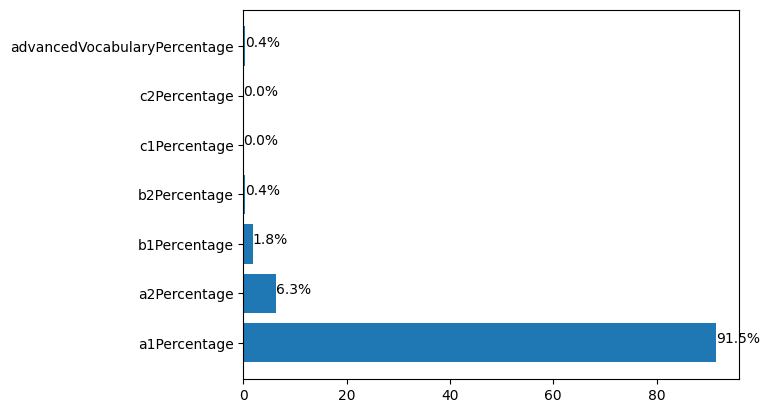

Word,numerous
You said,Acquaintances. It's a lot of a lot of people that I know.
We suggest,Acquaintances are numerous people that I know.
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/62b8c7fef2dd44bc9807c7103ce71cd8.wav


Word,seminar
You said,"I mean seminary with my with my job, with my, with my boss and my my team"
We suggest,"I mean seminar with my job, my boss, and my team"
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/56e5fa9fd5da4a239bbd8990d60fbbbb.wav


Word,unavailable
You said,I'm not I'm not available for for the next lesson.
We suggest,I'm unavailable for the next lesson.
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/a4141dfb31fc40abb21c97e2421c9058.wav


Word,called
You said,"They have a place who who names the Palace, Palace, mall."
We suggest,They have a place called the Palace Mall.
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/6e944f9a4ee64283b07ba1733a4fac78.wav


Word,proximity
You said,Near to neem.
We suggest,Close to neem.
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/c3280346294e4b96b59958c8e346a496.wav


Word,approximately
You said,"Hi, I'm in in half or for two days."
We suggest,"Hi, I'm here for approximately two days."
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/d22a0a4235a943dd9907d97f80230942.wav


Word,explore
You said,Yes. I looked around to to find my hotel.
We suggest,"Yes, I explored to find my hotel."
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/4d4c9796831d44caa67f5a17491adc4b.wav


Word,practice
You said,No I I'm I don't have the opportunity this this week to to to talk with but but I think I have to.
We suggest,"No, I haven't had the opportunity to practice with him this week, but I think I should."
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/316226110eb84e09a0e30b2598954b6b.wav


Word,nuance
You said,"The the the difference for me between set out and set off is is a, is a."
We suggest,The nuance between set out and set off is a bit difficult for me.
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/d09bf673f1ab4a5a98c0c624768e82d5.wav


Word,select
You said,It's a it's difficult to to choose the the the good one.
We suggest,It's difficult to select the right one.
Audio URL,https://fluency.blob.core.windows.net/publiccontainer/98b76f1daa2048119adafb702621ca02.wav


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick

display(HTML("<h1>Vocabulary</h1>"))

display(HTML(f"<h3>CEFR Level: {vocabularyProps['overallScore']}</h3>"))

cefr_distributions = vocabularyProps['vocabularyDistribution']
plt.barh(list(cefr_distribution.keys()), cefr_distribution.values())

for i, (cefr, percentage) in enumerate(cefr_distribution.items()):
    plt.text(percentage, i, "{:.1%}".format(percentage / 100))

advanced_vocabulary_percentage = "{:.0%}".format((cefr_distribution['b2Percentage'] + cefr_distribution['c1Percentage'] + cefr_distribution['c2Percentage']) / 100)

display(HTML(f"<h3>Advanced vocabulary: {advanced_vocabulary_percentage}</h3>"))

plt.show()


display(HTML(f"""<div>
    <h3>Advanced words correctly used</h3>
    <ul>
        {' '.join(["<li>" + w["word"] + " (" + w["cefr"] + ")</li>" for w in advanced_words])}
    </ul>
</div>"""))

for suggestion in vocabularyProps['suggestions']:
    display(HTML(f"""<table>
        <tr>
            <th>Word</th>
            <td>{suggestion['word']}</td>
        </tr>
        <tr>
            <th>You said</th>
            <td>    
            {''.join(['<u><b>' + fragment['text'] + '</b></u>' if 'isUnderlined' in fragment else fragment['text'] for fragment in suggestion['userSaid']['fragments']])}
            </td>
        </tr>
        <tr>
            <th>We suggest</th>
            <td>    
            {''.join(['<u><b>' + fragment['text'] + '</b></u>' if 'isUnderlined' in fragment else fragment['text'] for fragment in suggestion['suggestion']['fragments']])}
            </td>
        </tr>
        <tr>
            <th>Audio URL</th>
            <td>{suggestion['userSaidAudioUrl']}</td>
        </tr>
    </table>"""))

    display(ipd.Audio(suggestion['userSaidAudioUrl']))

# Pronunciation

In [ ]:
from pydub import AudioSegment

MAX_WORKERS = 20
TICKS_PER_MILLISECOND = 10000

student_transcript = ""

audio = AudioSegment.from_wav(os.path.join(WORKING_DIR, "audio.wav"))
student_audio = AudioSegment.empty()
segments = []
segment_start_ticks_in_audio = []

for i, recognizedPhrase in enumerate(transcription['recognizedPhrases']):
    if not recognizedPhrase['speaker'] == STUDENT_SPEAKER:
        continue

    best = recognizedPhrase['nBest'][0]

    student_transcript += best['display'] + "\n"

    start_milliseconds = best['displayWords'][0]['offsetInTicks'] / 10000
    end_milliseconds = (best['displayWords'][-1]['offsetInTicks'] + best['displayWords'][-1]['durationInTicks']) / 10000

    tmp_file_location = os.path.join(WORKING_DIR, f'pronunciation_tmp_audio_{i}.wav')
    audio[start_milliseconds:end_milliseconds].export(tmp_file_location, format="wav", bitrate="16k")

    segments.append({
        'file_location': tmp_file_location,
        'transcript': best['display']
    })
    
    segment_start_ticks_in_audio.append(student_audio.duration_seconds * TICKS_PER_MILLISECOND * 1000)
    student_audio += audio[start_milliseconds:end_milliseconds]

student_audio.export(os.path.join(WORKING_DIR, "student_audio.wav"), format="wav", bitrate="16k")
student_audio

In [ ]:
import azure.cognitiveservices.speech as speechsdk
from concurrent.futures import ThreadPoolExecutor

MAX_WORKERS = 100

# Following code adapted from 
# https://github.com/Azure-Samples/cognitive-services-speech-sdk/blob/master/samples/python/console/speech_sample.py

def speech_recognize_continuous_from_file(segment):
    """performs continuous speech recognition with input from an audio file"""
    # <SpeechContinuousRecognitionWithFile>

    pronunciation_assessment_config = speechsdk.PronunciationAssessmentConfig(json_string=json.dumps({"referenceText": segment['transcript'], "gradingSystem":"HundredMark", "granularity":"Phoneme"}))
    speech_config = speechsdk.SpeechConfig(subscription=SUBSCRIPTION_KEY, region=SERVICE_REGION)
    audio_config = speechsdk.audio.AudioConfig(filename=segment['file_location'])

    speech_recognizer = speechsdk.SpeechRecognizer(speech_config=speech_config, audio_config=audio_config)
    pronunciation_assessment_config.apply_to(speech_recognizer)

    done = False

    def stop_cb(evt):
        """callback that stops continuous recognition upon receiving an event `evt`"""
        print('CLOSING on {}'.format(evt))
        speech_recognizer.stop_continuous_recognition()
        nonlocal done
        done = True
        if result == '':
            print('stopping with no results')

    def handle_canceled(evt):
        print('CANCELED {}'.format(evt))
        cancellation_details = evt.result.cancellation_details
        print(f"Canceled with reason: {cancellation_details.reason}")

        if cancellation_details.reason == speechsdk.CancellationReason.Error:
            print(f"Error details: {cancellation_details.error_details}")

    # Connect callbacks to the events fired by the speech recognizer
    speech_recognizer.recognizing.connect(lambda evt: print('RECOGNIZING: {}'.format(evt)))
    speech_recognizer.recognized.connect(lambda evt: print('RECOGNIZED: {}'.format(evt)))
    results = []
    def handle_final_result(evt):
        nonlocal results
        results.append(evt.result)
    speech_recognizer.recognized.connect(handle_final_result)
    speech_recognizer.session_started.connect(lambda evt: print('SESSION STARTED: {}'.format(evt)))
    speech_recognizer.session_stopped.connect(lambda evt: print('SESSION STOPPED {}'.format(evt)))
    speech_recognizer.canceled.connect(handle_canceled)
    # stop continuous recognition on either session stopped or canceled events
    speech_recognizer.session_stopped.connect(stop_cb)
    speech_recognizer.canceled.connect(stop_cb)

    # Start continuous speech recognition
    speech_recognizer.start_continuous_recognition()

    while not done:
        time.sleep(3)
    
    return results
    # </SpeechContinuousRecognitionWithFile>


with ThreadPoolExecutor(max_workers=MAX_WORKERS) as executor:
    futures = [executor.submit(speech_recognize_continuous_from_file, segment) for segment in segments]
    for future in futures:
        future.result()

Okay.
Bugs. So as a qrcc manager I'm responsible for driving improvement of the company and of the site this.
I'm also in charge for of.
Environment and safe health and safety topic one of the, I would say, one of the biggest challenge is to create a culture.
SESSION STARTED: SessionEventArgs(session_id=127a4932369e45ed85b5d013234b1b30)
Safety culture and quality culture. We need people understand that the safety is is, yeah, safety first, no matter what. They need to to pay attention to where protection and to respect the rule that we have set.
And that's, that's mean a lot of communication a lot of training. But that's something really interesting for yeah regarding quality, I need to I deal with claim customer, claim internal nonconformity.SESSION STARTED: SessionEventArgs(session_id=79658570e4b34ddf9b0334bbda12f51b)

SESSION STARTED: SessionEventArgs(session_id=7fec62971ac249dfb31a4b174ecf18be)
Improvement project, Generic Improvement Project API. Okay, what can I said and yeah we 

In [ ]:
PRONUNCIATION_API_RESPONSE_FILENAME = 'pronunciation.json'

def futures_to_results(futures):
    results = []
    for future in futures:
        future_results = future.result()
        for result in future_results:
            results.append(json.loads(result.properties.get(speechsdk.PropertyId.SpeechServiceResponse_JsonResult)))
    return results

def adjust_offset_in_dict(d, offset_adjustment):
    for key, value in d.items():
        if isinstance(value, list):
            for el in value:
                adjust_offset_in_dict(el, offset_adjustment)
        if isinstance(value, dict):
            adjust_offset_in_dict(value, offset_adjustment)
        if key == 'Offset':
            d[key] += offset_adjustment

# All "Offset"s are in terms of the small audio files broken into segments of
# ~30 seconds. Let's re-adjust it so it is offsets in the larger
# student_audio file. 
def adjust_offset_in_results(results):
    for i, result in enumerate(results):
        adjust_offset_in_dict(result, segment_start_ticks_in_audio[i])

def add_json_label_to_results(results):
    # TODO: clean up so we don't need to manually add this label "json".
    # The only reason we have this is because the Web UI output has it, but the API output doesn't.
    # We initially wrote code assuming the output comes from the Web UI, so for now I'm just
    # formatting the output of API to be compatible with that.
    return [{"json": result} for result in results]

results = futures_to_results(futures)
adjust_offset_in_results(results)
# results = add_json_label_to_results(results)

with open(os.path.join(WORKING_DIR, PRONUNCIATION_API_RESPONSE_FILENAME), 'w') as f:
    f.write(json.dumps(results))

IndexError: ignored

In [ ]:
for future in futures:
    results = future.result()
    for result in results:
        r = json.loads(result.properties.get(speechsdk.PropertyId.SpeechServiceResponse_JsonResult))
        print(r['DisplayText'])


Okay.
Bugs.
A. So as a manager, I'm responsible for driving improvement.
A of the company and of the site.
A this.
I'm also in charge for of.
Environment and safe a health and safety a topic.
A would one of the, I would say one of the.
Biggest a.
Challenge is to create a culture.
Safety culture and quality culture.
We need people understand that the safety is.
Is, yeah. Safety first, no matter what they need to to pay attention to where protection and to respect the rule that we have set.
And that's a that's mean a lot of communication, a lot of a training.
But that's something really interesting.
A mean.
For yeah, regarding quality a mean I need to I deal with a claim, customer claim internal nonconformity.
Improvement.
Project.
Generic improvement project can.
API.
Okay, what can. I said.
And yeah.
We also.
Yeah.
We also a are supposed to organize audit.
We organize internal audits and we also a.
Have to.
Receive customers that want to audit a system, customers or third parties.
A fo

In [ ]:
for segment in segments:
    display(AudioSegment.from_wav(segment['file_location']))
    print(segment['transcript'])

Okay.


Bugs. So as a qrcc manager I'm responsible for driving improvement of the company and of the site this.


I'm also in charge for of.


Environment and safe health and safety topic one of the, I would say, one of the biggest challenge is to create a culture.


Safety culture and quality culture. We need people understand that the safety is is, yeah, safety first, no matter what. They need to to pay attention to where protection and to respect the rule that we have set.


And that's, that's mean a lot of communication a lot of training. But that's something really interesting for yeah regarding quality, I need to I deal with claim customer, claim internal nonconformity.


Improvement project, Generic Improvement Project API. Okay, what can I said and yeah we also.


Yeah.


We also are supposed to organize audit, we organize internal audits and we also have to receive customers that want to audit a system, customers or third parties for the certification.


And we follow also a supplier and evaluate quality of the of the supplier. So some person in my team are responsible for auditing the supplier going on site and so make the audit and follow the action after after the audit.


Regarding health and safety, we have to report every accident or names that that happen in your site and to investigate on the causes, the root cause, implement action and evaluate the efficiency of the action.


To be sure that what we have decide to set up is correct. What else?


Yeah, everyone is auditing. It's like a.


Yeah, never ending.


Yeah, I think I like it. In my previous job, I was doing a lot of audit. I was the person going and auditing.


Now I more often I'm the one with auditing. I'm not the auditor, but actually I kind of like.


This position because you can really show what you have done and if you're quite comfortable with, comfortable and confident with your system, it's, I mean it's okay, so it's usually you get often good good chat and interesting advice from the person in front of you. So it's quite nice.


No, I mean we have one tool for doing kind of inspection, yeah. Otherwise for the auditing, yeah, we built some forms to make it easier to answer, but when I'm performing them.


I do it from the old way and my way. I'm just writing on my question with a paper and then report it.


Slapdash. Slapdash.


Yeah, I will say that the auditors that I, I feels less as the ISO certification.


It's really easy.


Customer is the really okay it depend on the customer but when we get you have a big society you come and audit you and the and you can lost the certifications they gave you. It's it could have really a big big big impact on the company.


And and often there are more more strict.


Because yeah, it's I mean if we do, if we don't do well and if we produce defect it's themselves that's gonna be also in fact and then customer so.


Is it the first audit you? It's the first.


I know it.


Q HSE.


Typical tools.


Q HSE.


Yeah, subject.


I.


Environment, yeah, OK.


Yeah. Thank you.


No, I think it's.


Right. Yeah.


Yes, I think.


It's a factory, but it's really specific as well.


Manufacturing place.


Manufacturing.


Yeah, plant, can I, can I use a plant instead of company or it's it's similar to yeah similar to production?


Firm firm with a.


Honestly, I don't know.


OK.


So for example for simmer I can use company, but I cannot truly use firm.


I can sometimes talk about the production site.


We have a small one, but it will be only when we are talking about manufacturing I guess.


So is there other word or it's always company?


Yeah, I think I often do the mistake.


And I often use society right when I I.


Remember. Yeah, we talked. We already talked about it.


I am interviewing.


Being inter, yeah.


Audit I am auditing. No, no it's not.


I am being yes.


I am being auditing.


I'm being audited. Audited.


Follow follow up.


OK.


As a qhce manager, I am responsible for drive improvement. I am also responsible for.


It's difficult to to say it again. I deal with everything to do with environment and health and safety. I have to trade and implement a culture, safety culture and quality culture, which mean do training and a lot of communication.


On those subject, I am in charge of claims, customer claims, internal non compliance and any S accident and nearness. We perform audit, audit, internal audit and supplier audit.


Which include also to follow up the action and every time customer or third part are coming to evaluate our system, we contribute and participate to the audit we are being audited.


Okay, is that okay?


Right. I was concentrate.


Yes.


Yeah. The first one, yes, HSE. Yes. Yeah, you.


Is there a way to do it and to say it in English? Otherwise I say quality manager but when I say that I get the impression that all the environment part and safety part is missing.


But if you explain it after it's not big there. But don't know if there is a common word to say it in English.


HQ.


SE.


Yeah, I stick to the first one, yeah.


Yeah, yes.


Cmr is walking in.


Two markets, so one which is owning the most is wiring system.


It's about, yeah, wiring is okay for you, do you?


Yeah, yeah, but for on motor engine.


And it's, yeah, I think that's the world and but in France we don't produce that anymore. It's produced only in Tunisia, in a factory in Tunisia and in China. And the customer this market is really based on one.


A huge customer which is Cummins and is the, I think the the Ed office is in England, so we have a site in England which is really dealing with this customer.


Cummins.


See next cu MMINS.


The second market is the sensors. We produce sensor also for engine, but also for power plant and that's what we we produce in France, we make sensors, we manufacture sensor, we also manufacture sensor in Tunisia. The the sensor we manufacture in France are only for nuclear plants, they are power plants.


Yes.


Yes, it's a project. It's just starting right now. So yeah, now we get to somewhere. We also produce for inclave point.


I think it's will be advanced which is more or less the same.


It's English authority what I am understanding at the end it's always come to EDF.


We come back to Ed.


KeyboardInterrupt: ignored

## Manual Process

1. Go to speech.microsoft.com
2. Open "Pronunciation assessment"
3. Enter following script and upload student_audio.*wav*
4. Save content to pronunciation.json and run notebook below

In [ ]:
student_transcript

"Oh yeah. Yes, I think I can just talk about a generally and without touch any confidential information. Yes, this week I'm pretty busy and involved in my work because my my daily work include the patent prosecution and patent litigation.\nYeah. So when I don't work on patent litigation case, my time is controllable. Yeah, I can just arrange the patent prosecution work step by step because for each of patent prosecution work, it's there is a deadline far from my from the current date. Yes. So I can plan in a good way.\nYeah. But for the pattern litigation case, sometimes the work is unpredictable. Yeah. So once there is some work occur, I just need to go on to work on it and finish it in short time. Yeah. So sometimes if the two work just has had some O life and I need work on both of them.\nI will be very busy. Yeah. I need to finish both of them in time. Yeah. So this time this is very, will be very challenging. Yeah. I need to make sure I can finish all the products on time with goo

In [ ]:
import json

with open(os.path.join(WORKING_DIR, PRONUNCIATION_API_RESPONSE_FILENAME), 'r') as f:
    file_contents = f.read()
    pronunciation_response = json.loads(file_contents)

In [ ]:
import itertools
import numpy as np
import re

# show the top NUM_PHONEMES_TO_IMPROVE worst pronounced phonemes
NUM_PHONEMES_TO_IMPROVE = 10

def validate_phoneme(phoneme):
    if phoneme is None:
      return False
    phoneme_score = phoneme["PronunciationAssessment"]["AccuracyScore"]
    word_score = phoneme["WordPronunciationAssessment"]["AccuracyScore"]
    threshold = 80
    pronunciation_can_improve = (phoneme_score <= threshold) and (word_score <= threshold)
    # if we can't detect the speaker, be lenient
    speaker_is_not_teacher = phoneme.get("Speaker", "Student") != 'Teacher'
    # return pronunciation_can_improve and phoneme['Word'] not in { 'to' }
    return (phoneme['Word'] not in { 'to' }) and speaker_is_not_teacher

def is_valid_example_occurrence(phoneme):
    phoneme_score = phoneme["PronunciationAssessment"]["AccuracyScore"]
    word_score = phoneme["WordPronunciationAssessment"]["AccuracyScore"]
    threshold = 80
    pronunciation_can_improve = (phoneme_score <= threshold) and (word_score <= threshold)
    return pronunciation_can_improve

def score_function(phoneme_score, word_score):
  if word_score > 60:
    return max(word_score, phoneme_score)
  return (phoneme_score + word_score) / 2

def format_string_for_matching(s):
  return re.sub(r'[^\w\s]', '', s).lower()

def get_matching_transcription_line(item, full_transcription_lines):
  display_text = get_display_text(item)
  split_display_text = display_text.split(" ")
  first_few_words = format_string_for_matching(" ".join(split_display_text[:5]))
  last_few_words = format_string_for_matching(" ".join(split_display_text[-5:]))
  first_many_words = format_string_for_matching(" ".join(split_display_text[:8]))
  last_many_words = format_string_for_matching(" ".join(split_display_text[-8:]))
  transcription_line_matches_loose = [
      line for line in full_transcription_lines \
      if (first_few_words.lower() in format_string_for_matching(line['line'])) or 
        (last_few_words.lower() in format_string_for_matching(line['line']))
  ]
  transcription_line_matches_strict = [
      line for line in full_transcription_lines \
      if (first_many_words.lower() in format_string_for_matching(line['line'])) or 
        (first_many_words.lower() in format_string_for_matching(line['line']))
  ]
  num_matches_loose = len(transcription_line_matches_loose)
  num_matches_strict = len(transcription_line_matches_strict)
  if num_matches_loose != 1 and num_matches_strict != 1:
    return (None, num_matches_strict)
  elif num_matches_loose == 1:
    return (transcription_line_matches_loose[0], 1)
  return (transcription_line_matches_strict[0], 1)

def get_display_text(item):
  return item.get('text', item['json'].get('DisplayText', item['json'].get('Text')))

def get_pronunication_assessment(item):
  return item['json']['NBest'][0]

def phoneme_level_score_info(phoneme, word, item, full_transcription_lines):
  display_text = get_display_text(item)
  (transcription_line, num_matches) = get_matching_transcription_line(item, full_transcription_lines)

  return {
    "Phoneme": phoneme["Phoneme"],
    "PronunciationAssessment": phoneme["PronunciationAssessment"],
    "PhonemeOffset": phoneme["Offset"],
    "PhonemeDuration": phoneme["Duration"],
    "Word": word["Word"],
    "WordPronunciationAssessment": word["PronunciationAssessment"],
    "WordOffset": word["Offset"],
    "WordDuration": word["Duration"],
    "OverallScore": score_function(
        phoneme["PronunciationAssessment"]["AccuracyScore"],
        word["PronunciationAssessment"]["AccuracyScore"]
      ),
    "DisplayText": display_text,
    "Speaker": transcription_line.get('speaker') if transcription_line is not None else None,
  }

def aggregate_azure_output(raw_output, full_transcription_lines):
    full_text = " ".join([get_display_text(item) for item in raw_output])

    phrase_to_speaker_map = {
        line['line'].lower(): line['speaker'] for line in full_transcription_lines
    }

    raw_phoneme_level_scores = [
        phoneme_level_score_info(phoneme, word, item, full_transcription_lines) \
        for item in raw_output if 'NBest' in item['json'] \
        for word in get_pronunication_assessment(item)['Words'] \
        for phoneme in word['Phonemes']
      ]
    print(f'[raw_phoneme_level_scores] have {len(raw_phoneme_level_scores)} raw phoneme scores')
    
    phoneme_level_scores = [phoneme for phoneme in raw_phoneme_level_scores if validate_phoneme(phoneme)]
    print(f'[phoneme_level_scores] have {len(raw_phoneme_level_scores)} valid phoneme scores')


    sorted_phoneme_level_scores = sorted(phoneme_level_scores, key=lambda x:x['Phoneme'])
    grouped_scores = itertools.groupby(sorted_phoneme_level_scores, key=lambda x:x['Phoneme'])

    aggregated_phoneme_scores = []
    for phoneme, grouped_score_for_phoneme in grouped_scores:
        grouped_score = list(grouped_score_for_phoneme)
        num_scores = len(grouped_score)

        # discard phonemes that were pronounced fewer than 3 times
        if num_scores < 3:
            continue

        accuracy_scores = [score['OverallScore'] for score in grouped_score]
        example_occurrences = [
            occurrence for occurrence in grouped_score if is_valid_example_occurrence(occurrence)
            ]
        if len(example_occurrences) < 1:
          continue
        worst_occurrences = sorted(example_occurrences, key=lambda x:x['OverallScore'])[:5]
        aggregated_phoneme_scores.append({
            'phoneme': phoneme,
            'avg_score': np.mean(accuracy_scores),
            'median_score': np.median(accuracy_scores),
            'first_quartile': np.percentile(accuracy_scores, 25),
            'num_scores': num_scores,
            'worst_occurences': worst_occurrences
            # 'raw_scores': grouped_score,
        })
    print(f'[aggregated_phoneme_scores] have {len(aggregated_phoneme_scores)} aggregated phoneme scores')

    # sort in ascending order by median score
    sorted_aggregated_phoneme_scores = sorted(
      aggregated_phoneme_scores,
      key=lambda x:x['first_quartile']
    )

    return {
        'full_text': full_text,
        'phonemes_to_improve': sorted_aggregated_phoneme_scores[:NUM_PHONEMES_TO_IMPROVE],
    }


In [ ]:
aggregated_azure_output = None

with open(os.path.join(WORKING_DIR, PRONUNCIATION_API_RESPONSE_FILENAME)) as f:
    raw_azure_output = json.loads(f.read())
    pronunciation_scores = [
        get_pronunication_assessment(item)['PronunciationAssessment']['AccuracyScore'] \
        for item in raw_azure_output if 'NBest' in item['json']
      ]
    print('Pronunciation Score: {} (based on {} samples)\n\n'.format(
        np.mean(pronunciation_scores),
        len(pronunciation_scores))
    )
    aggregated_azure_output = aggregate_azure_output(raw_azure_output, full_transcription_lines)

Pronunciation Score: 90.2 (based on 5 samples)


[raw_phoneme_level_scores] have 675 raw phoneme scores
[phoneme_level_scores] have 675 valid phoneme scores
[aggregated_phoneme_scores] have 32 aggregated phoneme scores


In [ ]:
from pydub import AudioSegment

phonemes_to_improve = aggregated_azure_output['phonemes_to_improve']

one_second = 1000
factor = 10000

raw_audio = AudioSegment.from_wav(AUDIO_FILE)
display(raw_audio)

for phoneme in phonemes_to_improve:
  print("Phoneme: {}. Phoneme Score: {}".format(phoneme['phoneme'], phoneme['first_quartile']))
  words_shown = {}
  for occurrence in phoneme['worst_occurences']:
    word = occurrence['Word']

    # don't show the same word more than once
    if word in words_shown:
      continue
    
    words_shown[word] = True
    student_audio_word_start = (occurrence['WordOffset'] / factor)
    student_audio_word_end = student_audio_word_start + (occurrence['WordDuration'] / factor)
    student_audio_word_start_sec = student_audio_word_start / 1000
    student_audio_word_end_sec = student_audio_word_end / 1000
    word = occurrence['Word']
    overall_score = occurrence['OverallScore']
    word_score = occurrence['WordPronunciationAssessment']['AccuracyScore']
    phoneme_score = occurrence['PronunciationAssessment']['AccuracyScore']
    speaker = occurrence['Speaker']

    print(f'Word: {word}, OverallScore: {overall_score}, Word Score: {word_score}, ' + 
          f'Phoneme Score: {phoneme_score}, Speaker: {speaker}, ' + 
          'Start Time: {}, End Time: {}'.format(
      '{}:{:.0f}'.format(int(student_audio_word_start_sec / 60), math.floor(student_audio_word_start_sec % 60)),
      '{}:{:.0f}'.format(int(student_audio_word_end_sec / 60), math.ceil(student_audio_word_end_sec % 60))
      ))
    display(student_audio[(student_audio_word_start - one_second):(student_audio_word_end + one_second)])

Phoneme: ao. Phoneme Score: 71.0
Word: talk, OverallScore: 79.0, Word Score: 79.0, Phoneme Score: 48.0, Speaker: Student, Start Time: 0:2, End Time: 0:3


Phoneme: v. Phoneme Score: 73.0
Word: very, OverallScore: 68.0, Word Score: 67.0, Phoneme Score: 68.0, Speaker: Student, Start Time: 1:21, End Time: 1:23


Word: involved, OverallScore: 70.0, Word Score: 63.0, Phoneme Score: 70.0, Speaker: Student, Start Time: 0:10, End Time: 0:12


Word: of, OverallScore: 75.0, Word Score: 75.0, Phoneme Score: 59.0, Speaker: Student, Start Time: 1:15, End Time: 1:16


Phoneme: ae. Phoneme Score: 76.25
Word: can, OverallScore: 30.0, Word Score: 53.0, Phoneme Score: 7.0, Speaker: Student, Start Time: 1:24, End Time: 1:25


Word: patent, OverallScore: 49.5, Word Score: 48.0, Phoneme Score: 51.0, Speaker: Student, Start Time: 0:33, End Time: 0:34


Word: plan, OverallScore: 71.0, Word Score: 71.0, Phoneme Score: 67.0, Speaker: Student, Start Time: 0:42, End Time: 0:44


Word: challenging, OverallScore: 74.0, Word Score: 74.0, Phoneme Score: 65.0, Speaker: Student, Start Time: 1:22, End Time: 1:23


Word: pattern, OverallScore: 76.0, Word Score: 71.0, Phoneme Score: 76.0, Speaker: Student, Start Time: 0:46, End Time: 0:47


Phoneme: dh. Phoneme Score: 76.5
Word: them, OverallScore: 6.5, Word Score: 4.0, Phoneme Score: 9.0, Speaker: Student, Start Time: 1:15, End Time: 1:16


Word: this, OverallScore: 65.0, Word Score: 65.0, Phoneme Score: 52.0, Speaker: Student, Start Time: 1:18, End Time: 1:19


Phoneme: p. Phoneme Score: 78.0
Word: patent, OverallScore: 65.5, Word Score: 60.0, Phoneme Score: 71.0, Speaker: Student, Start Time: 0:21, End Time: 0:22


Word: unpredictable, OverallScore: 66.0, Word Score: 66.0, Phoneme Score: 55.0, Speaker: Student, Start Time: 0:49, End Time: 0:52


Word: pattern, OverallScore: 71.0, Word Score: 71.0, Phoneme Score: 62.0, Speaker: Student, Start Time: 0:46, End Time: 0:47


Phoneme: b. Phoneme Score: 82.0
Word: because, OverallScore: 50.0, Word Score: 41.0, Phoneme Score: 59.0, Speaker: Student, Start Time: 0:31, End Time: 0:33


Word: but, OverallScore: 50.0, Word Score: 41.0, Phoneme Score: 59.0, Speaker: Student, Start Time: 0:45, End Time: 0:46


Phoneme: d. Phoneme Score: 82.0
Word: involved, OverallScore: 63.0, Word Score: 63.0, Phoneme Score: 63.0, Speaker: Student, Start Time: 0:10, End Time: 0:12


Word: good, OverallScore: 64.0, Word Score: 53.0, Phoneme Score: 75.0, Speaker: Student, Start Time: 1:28, End Time: 1:30


Word: deadline, OverallScore: 76.0, Word Score: 76.0, Phoneme Score: 30.0, Speaker: Student, Start Time: 0:37, End Time: 0:39


Phoneme: g. Phoneme Score: 82.0
Word: good, OverallScore: 40.5, Word Score: 53.0, Phoneme Score: 28.0, Speaker: Student, Start Time: 1:28, End Time: 1:30


Phoneme: t. Phoneme Score: 82.25
Word: patent, OverallScore: 26.5, Word Score: 48.0, Phoneme Score: 5.0, Speaker: Student, Start Time: 0:33, End Time: 0:34


Word: but, OverallScore: 32.0, Word Score: 41.0, Phoneme Score: 23.0, Speaker: Student, Start Time: 0:45, End Time: 0:46


Phoneme: n. Phoneme Score: 83.5
Word: patent, OverallScore: 38.5, Word Score: 60.0, Phoneme Score: 17.0, Speaker: Student, Start Time: 0:21, End Time: 0:22


Word: can, OverallScore: 43.5, Word Score: 53.0, Phoneme Score: 34.0, Speaker: Student, Start Time: 1:24, End Time: 1:25


Word: involved, OverallScore: 63.0, Word Score: 63.0, Phoneme Score: 37.0, Speaker: Student, Start Time: 0:10, End Time: 0:12


Word: unpredictable, OverallScore: 66.0, Word Score: 66.0, Phoneme Score: 43.0, Speaker: Student, Start Time: 0:49, End Time: 0:52


In [ ]:
def generate_pronunciation_feedback_audio_data(aggregated_azure_output):
    pronunciation_feedback_audio = []

    ticks_per_millisecond = 10000
    one_second_millis = 1000

    for phonemeIndex, phonemeInfo in enumerate(aggregated_azure_output['phonemes_to_improve']):
      pronunciation_feedback_audio.append([])
      occurrences = phonemeInfo["worst_occurences"][:3]
      for occurrenceIndex, occurrence in enumerate(occurrences):
        word = occurrence['Word']
        startMilliseconds = (occurrence['WordOffset'] / ticks_per_millisecond) - one_second_millis
        endMilliseconds = ((occurrence['WordOffset'] + occurrence['WordDuration']) / ticks_per_millisecond) + one_second_millis
        newAudio = student_audio[startMilliseconds:endMilliseconds]
        newAudioFilename = f'pronunciation_audio_{phonemeIndex}_{occurrenceIndex}.wav'
        newAudio.export(os.path.join(WORKING_DIR, newAudioFilename), format="wav")  
        audioID = f"{uuid.uuid4().hex}.wav"
        audioUrl = upload_to_blob_storage(os.path.join(WORKING_DIR, newAudioFilename), audioID)
        display_text = occurrence['DisplayText']
        display_text_split = display_text.split(" ")
        correct_pronunication_text_split = display_text_split
        word_match_indices = [
            index for (display_word, index) in zip(display_text_split, range(len(display_text_split))) \
            if word.lower() == display_word.lower()
        ]
        if len(word_match_indices) > 0:
          word_buffer = 3
          start_index = max(0, word_match_indices[0] - word_buffer)
          end_index = min(len(display_text_split), word_match_indices[-1] + word_buffer)
          correct_pronunication_text_split = display_text_split[start_index:end_index]

        correct_pronunciation_text = " ".join(correct_pronunication_text_split)

        pronunciation_feedback_audio[phonemeIndex].append({
            'userPronunciationAudioUrl': audioUrl,
            'correctPronunciationText': correct_pronunciation_text,
        })
    return pronunciation_feedback_audio

def get_pronunication_props():
  pronunciation_feedback_audio = generate_pronunciation_feedback_audio_data(aggregated_azure_output)

  feedback_items = [
      {
          "phoneme": phonemeInfo["phoneme"],
          "phonemeScore": round(phonemeInfo["first_quartile"]),
          "audioComparisons": [
              {
                "underlinedWord": {
                    "fragments": [{
                        "text": occurrence["Word"]
                    }]
                },
                "userPronunciationAudioUrl": pronunciation_feedback_audio[phonemeIndex][occurrenceIndex]['userPronunciationAudioUrl'],
                "correctPronunciationText": pronunciation_feedback_audio[phonemeIndex][occurrenceIndex]['correctPronunciationText']
              } for occurrenceIndex, occurrence in enumerate(phonemeInfo["worst_occurences"][:3])
          ]
      } for phonemeIndex, phonemeInfo in enumerate(aggregated_azure_output['phonemes_to_improve'])
  ]

  pronunciation_props = {
      "overallScore": f'{round(np.mean(pronunciation_scores))}',
      "cferScore": "B1", # TODO: calculate properly
      "feedbackItems": feedback_items,
  }
  return pronunciation_props


In [ ]:
pronunciationProps = get_json_from_func_or_cache(get_pronunication_props, 'pronunciationProps.json')

Uploaded 49fdc367f2e147b2b398516bf2270e19.wav.
Uploaded 086dc20da9104d2e9916b4d812f004cd.wav.
Uploaded cb138d02c0d44bab836558168946c547.wav.
Uploaded 054677c4b6de4364a7c4b6ec38748af1.wav.
Uploaded 0e9821960261470a8b5140459198ebcc.wav.
Uploaded db30ab5551bb4d8589a8a160683cba4b.wav.
Uploaded 0424daa20cd44dcbba4fa73350321cd0.wav.
Uploaded fda973c8b7974d718b9aed62caecb0bc.wav.
Uploaded 302817dcc6674acbb5423d7a8dedb7b6.wav.
Uploaded f89df8199c3a49a3924360f50eab37d1.wav.
Uploaded 063d3f0eaedd40f4bc6119ec03ca1ce1.wav.
Uploaded 47e3061e13d94e2882026fb8ce84a82d.wav.
Uploaded 7236b122d24c467db38a8092101692f8.wav.
Uploaded a773525429d84584a1de8f18f78860db.wav.
Uploaded 353753be8c2b4edf9b9b5ca1f3b66906.wav.
Uploaded 802474b9a2df4baf9db0e471027a4370.wav.
Uploaded e66ababd2d8c4489bfde142e1ce377e5.wav.
Uploaded 52f9c690a85c4475be8f45efd5a3e2f7.wav.
Uploaded e80cc36cd56c42c98fc8bbb44f61a8c2.wav.
Uploaded b058692935704aa39ef6925a20067e92.wav.
Uploaded b2b2ff5704444d3f8d04b07110bd6bd5.wav.
Uploaded 1f8f

# Aggregating Output

In [ ]:
import pprint
import uuid

props = {
    'reportID': str(uuid.uuid4()),
    'transcriptProps': transcriptProps,
    'overallProps': overallProps,
    'grammarProps': grammarProps,
    'pronunciationProps': pronunciationProps,
    'vocabularyProps': vocabularyProps,
}
propsJson = json.dumps(props, indent=2)
with open(os.path.join(WORKING_DIR, OUTPUT_JSON_FILE_NAME), 'w') as f:
    f.write(propsJson)

# pprint.pprint(json.loads(propsJson))

In [ ]:
from google.colab import files

files.download(os.path.join(WORKING_DIR, OUTPUT_JSON_FILE_NAME))

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Scratch Code

In [ ]:
# # currently using unofficial API. https://pypi.org/project/revChatGPT/
# # Swap out with a real API once that's available.
# class GPT:
#     def __init__(self, transcript):
#         self.chatbot = Chatbot(config={
#             "email": CHAT_GPT_EMAIL,
#             "password": CHAT_GPT_PASSWORD
#         })
        
#         self.transcript = transcript
        
#     def ask(self, prompt):
#         for data in self.chatbot.ask(prompt):
#             response = data["message"]
#         with open(os.path.join(WORKING_DIR, "gpt.log"), "a") as f:
#             f.write(response)
#             f.write("\n")
#         return response
        
#     def ask_with_entire_transcript(self, prompt):
#         return self.ask(prompt + '\n\n' + self.transcript)
        
#     def ask_with_transcript(self, prompt, transcript):
#         return self.ask(prompt + '\n\n' + transcript)

# gpt = GPT(full_transcription_with_speakers)

In [ ]:
# copied from Azure tutorial https://github.com/Azure-Samples/cognitive-services-speech-sdk/blob/master/samples/python/console/speech_sample.py
def pronunciation_assessment_continuous_from_file():
    """Performs continuous pronunciation assessment asynchronously with input from and audio file.
        See more information at https://aka.ms/csspeech/pa"""

    import difflib
    import json

    # Creates an instance of a speech config with specified subscription key and service region.
    # Replace with your own subscription key and service region (e.g., "westus").
    # Note: The pronunciation assessment feature is currently only available on en-US language.
    speech_config = speechsdk.SpeechConfig(subscription=SUBSCRIPTION_KEY, region=SERVICE_REGION)
    audio_config = speechsdk.audio.AudioConfig(filename=os.path.join(WORKING_DIR, 'audio_1.wav'))

    reference_text = full_transcription_without_speakers
    # create pronunciation assessment config, set grading system, granularity and if enable miscue based on your requirement.
    enable_miscue = True
    pronunciation_config = speechsdk.PronunciationAssessmentConfig(
        reference_text=reference_text,
        grading_system=speechsdk.PronunciationAssessmentGradingSystem.HundredMark,
        granularity=speechsdk.PronunciationAssessmentGranularity.Phoneme,
        enable_miscue=enable_miscue)

    # Creates a speech recognizer using a file as audio input.
    language = 'en-US'
    speech_recognizer = speechsdk.SpeechRecognizer(speech_config=speech_config, language=language, audio_config=audio_config)
    # apply pronunciation assessment config to speech recognizer
    pronunciation_config.apply_to(speech_recognizer)

    done = False
    recognized_words = []
    fluency_scores = []
    durations = []

    def stop_cb(evt: speechsdk.SessionEventArgs):
        """callback that signals to stop continuous recognition upon receiving an event `evt`"""
        print('CLOSING on {}'.format(evt))
        nonlocal done
        done = True

    def recognized(evt: speechsdk.SpeechRecognitionEventArgs):
        print('pronunciation assessment for: {}'.format(evt.result.text))
        pronunciation_result = speechsdk.PronunciationAssessmentResult(evt.result)
        print('    Accuracy score: {}, pronunciation score: {}, completeness score : {}, fluency score: {}'.format(
            pronunciation_result.accuracy_score, pronunciation_result.pronunciation_score,
            pronunciation_result.completeness_score, pronunciation_result.fluency_score
        ))
        nonlocal recognized_words, fluency_scores, durations
        recognized_words += pronunciation_result.words
        fluency_scores.append(pronunciation_result.fluency_score)
        json_result = evt.result.properties.get(speechsdk.PropertyId.SpeechServiceResponse_JsonResult)
        jo = json.loads(json_result)
        nb = jo['NBest'][0]
        durations.append(sum([int(w['Duration']) for w in nb['Words']]))

    # Connect callbacks to the events fired by the speech recognizer
    speech_recognizer.recognized.connect(recognized)
    speech_recognizer.session_started.connect(lambda evt: print('SESSION STARTED: {}'.format(evt)))
    speech_recognizer.session_stopped.connect(lambda evt: print('SESSION STOPPED {}'.format(evt)))
    speech_recognizer.canceled.connect(lambda evt: print('CANCELED {}'.format(evt)))
    # stop continuous recognition on either session stopped or canceled events
    speech_recognizer.session_stopped.connect(stop_cb)
    speech_recognizer.canceled.connect(stop_cb)

    # Start continuous pronunciation assessment
    speech_recognizer.start_continuous_recognition()
    while not done:
        time.sleep(.5)

    speech_recognizer.stop_continuous_recognition()

    # we need to convert the reference text to lower case, and split to words, then remove the punctuations.
    if language == 'zh-CN':
        # Use jieba package to split words for Chinese
        import jieba
        import zhon.hanzi
        jieba.suggest_freq([x.word for x in recognized_words], True)
        reference_words = [w for w in jieba.cut(reference_text) if w not in zhon.hanzi.punctuation]
    else:
        reference_words = [w.strip(string.punctuation) for w in reference_text.lower().split()]

    # For continuous pronunciation assessment mode, the service won't return the words with `Insertion` or `Omission`
    # even if miscue is enabled.
    # We need to compare with the reference text after received all recognized words to get these error words.
    if enable_miscue:
        diff = difflib.SequenceMatcher(None, reference_words, [x.word for x in recognized_words])
        final_words = []
        for tag, i1, i2, j1, j2 in diff.get_opcodes():
            if tag in ['insert', 'replace']:
                for word in recognized_words[j1:j2]:
                    if word.error_type == 'None':
                        word._error_type = 'Insertion'
                    final_words.append(word)
            if tag in ['delete', 'replace']:
                for word_text in reference_words[i1:i2]:
                    word = speechsdk.PronunciationAssessmentWordResult({
                        'Word': word_text,
                        'PronunciationAssessment': {
                            'ErrorType': 'Omission',
                        }
                    })
                    final_words.append(word)
            if tag == 'equal':
                final_words += recognized_words[j1:j2]
    else:
        final_words = recognized_words

    # We can calculate whole accuracy by averaging
    final_accuracy_scores = []
    for word in final_words:
        if word.error_type == 'Insertion':
            continue
        else:
            final_accuracy_scores.append(word.accuracy_score)
    accuracy_score = sum(final_accuracy_scores) / len(final_accuracy_scores)
    # Re-calculate fluency score
    fluency_score = sum([x * y for (x, y) in zip(fluency_scores, durations)]) / sum(durations)
    # Calculate whole completeness score
    completeness_score = len([w for w in recognized_words if w.error_type == "None"]) / len(reference_words) * 100
    completeness_score = completeness_score if completeness_score <= 100 else 100

    print('    Paragraph accuracy score: {}, completeness score: {}, fluency score: {}'.format(
        accuracy_score, completeness_score, fluency_score
    ))

    for idx, word in enumerate(final_words):
        print('    {}: word: {}\taccuracy score: {}\terror type: {};'.format(
            idx + 1, word.word, word.accuracy_score, word.error_type
        ))

pronunciation_assessment_continuous_from_file()

NameError: ignored